In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# Data Preprocessing 

In [2]:
training_set = tf.keras.utils.image_dataset_from_directory(
    'train',
    labels="inferred",
    label_mode="categorical",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(128, 128),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation="bilinear",
    follow_links=False,
    crop_to_aspect_ratio=False,
)

Found 140590 files belonging to 38 classes.


In [3]:
valid_set = tf.keras.utils.image_dataset_from_directory(
    'valid',
    labels="inferred",
    label_mode="categorical",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(128, 128),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation="bilinear",
    follow_links=False,
    crop_to_aspect_ratio=False,
)

Found 35144 files belonging to 38 classes.


In [4]:
for x,y in training_set:
    print(x,x.shape)
    print(y,y.shape)

tf.Tensor(
[[[[194.25 191.25 186.25]
   [192.75 189.75 184.75]
   [197.   194.   189.  ]
   ...
   [175.   173.   174.  ]
   [172.25 170.25 171.25]
   [185.75 183.75 184.75]]

  [[186.25 183.25 178.25]
   [189.5  186.5  181.5 ]
   [193.75 190.75 185.75]
   ...
   [178.   176.   177.  ]
   [172.5  170.5  171.5 ]
   [170.   168.   169.  ]]

  [[190.   187.   182.  ]
   [193.25 190.25 185.25]
   [194.25 191.25 186.25]
   ...
   [180.5  178.5  179.5 ]
   [178.   176.   177.  ]
   [179.25 177.25 178.25]]

  ...

  [[150.75 141.75 136.75]
   [135.5  126.5  121.5 ]
   [141.5  132.5  127.5 ]
   ...
   [118.5  110.5  108.5 ]
   [125.75 117.75 115.75]
   [121.   113.   111.  ]]

  [[136.5  127.5  122.5 ]
   [152.25 143.25 138.25]
   [140.25 131.25 126.25]
   ...
   [106.    98.    96.  ]
   [120.   112.   110.  ]
   [129.75 121.75 119.75]]

  [[144.75 135.75 130.75]
   [160.   151.   146.  ]
   [144.   135.   130.  ]
   ...
   [116.75 108.75 106.75]
   [109.   101.    99.  ]
   [127.5  119.5  11

In [5]:
from tensorflow.keras.layers import Dense, Conv2D,MaxPool2D,Flatten,Dropout
from tensorflow.keras.models import Sequential

In [6]:
model = Sequential()

In [7]:
# Building the convolution layers
model.add(Conv2D(filters=32,kernel_size=3,padding='same',activation='relu',input_shape=(128,128,3)))
model.add(Conv2D(filters=32,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))

In [8]:
model.add(Conv2D(filters=64,kernel_size=3,padding='same',activation='relu'))
model.add(Conv2D(filters=64,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))

In [9]:
model.add(Conv2D(filters=128,kernel_size=3,padding='same',activation='relu'))
model.add(Conv2D(filters=128,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))

In [10]:
model.add(Conv2D(filters=256,kernel_size=3,padding='same',activation='relu'))
model.add(Conv2D(filters=256,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))

In [11]:
model.add(Conv2D(filters=512,kernel_size=3,padding='same',activation='relu'))
model.add(Conv2D(filters=512,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))

In [12]:
model.add(Dropout(0.25)) # to avoid overfitting

In [13]:
model.add(Flatten())

In [14]:
model.add(Dense(units=1500,activation='relu'))

In [15]:
model.add(Dropout(0.4))

In [16]:
# Output layer
model.add(Dense(units=38, activation='softmax'))

# Compiling the model

In [17]:
model.compile(optimizer=tf.keras.optimizers.Adam(
    learning_rate=0.0001),loss='categorical_crossentropy',metrics=['accuracy'])

In [18]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 32)      896       
                                                                 
 conv2d_1 (Conv2D)           (None, 126, 126, 32)      9248      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 32)       0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 63, 63, 64)        18496     
                                                                 
 conv2d_3 (Conv2D)           (None, 61, 61, 64)        36928     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 30, 30, 64)       0         
 2D)                                                    

## To avoid overshooting of loss function
1. Choose small learning rate default = 0.001 we are taking 0.0001
2. There may be a chance of underfitting, so increase no of nuerons
3. Add more convolution layer to extract more feature from image 

# Model Training

In [19]:
training_history = model.fit(x = training_set,validation_data=valid_set,epochs=10)


Epoch 1/10


4394/4394 [==============================] - 420s 92ms/step - loss: 0.9223 - accuracy: 0.7228 - val_loss: 0.2763 - val_accuracy: 0.9115
Epoch 2/10
4394/4394 [==============================] - 687s 156ms/step - loss: 0.2313 - accuracy: 0.9249 - val_loss: 0.1721 - val_accuracy: 0.9468
Epoch 3/10
4394/4394 [==============================] - 546s 124ms/step - loss: 0.1273 - accuracy: 0.9583 - val_loss: 0.1735 - val_accuracy: 0.9470
Epoch 4/10
4394/4394 [==============================] - 423s 96ms/step - loss: 0.0848 - accuracy: 0.9724 - val_loss: 0.1729 - val_accuracy: 0.9450
Epoch 5/10
4394/4394 [==============================] - 477s 109ms/step - loss: 0.0613 - accuracy: 0.9806 - val_loss: 0.1587 - val_accuracy: 0.9529
Epoch 6/10
4394/4394 [==============================] - 418s 95ms/step - loss: 0.0498 - accuracy: 0.9841 - val_loss: 0.0983 - val_accuracy: 0.9705
Epoch 7/10
4394/4394 [==============================] - 421s 96ms/step - loss: 0.0409 - accuracy: 0.9870 - val_loss: 0.0970 - 

# Model Evaluation

In [20]:
train_loss,train_acc = model.evaluate(training_set)
valid_loss,valid_acc = model.evaluate(valid_set)

1099/1099 [==============================] - 32s 29ms/step - loss: 0.0932 - accuracy: 0.9758


# Saving Model

In [21]:
model.save('trained_model.keras')

In [22]:
training_history.history

{'loss': [0.922261118888855,
  0.23127421736717224,
  0.12734836339950562,
  0.08478830009698868,
  0.061312127858400345,
  0.04980415105819702,
  0.040869321674108505,
  0.03548802062869072,
  0.03094390593469143,
  0.02769768424332142],
 'accuracy': [0.7227896451950073,
  0.9248666167259216,
  0.9583113789558411,
  0.9724304676055908,
  0.9806458353996277,
  0.9841382503509521,
  0.9869691729545593,
  0.9889252185821533,
  0.9902980327606201,
  0.9912582635879517],
 'val_loss': [0.2763388752937317,
  0.1720961332321167,
  0.17351245880126953,
  0.17287200689315796,
  0.15866850316524506,
  0.0982699766755104,
  0.0969836488366127,
  0.08702567964792252,
  0.12087123095989227,
  0.09319858998060226],
 'val_accuracy': [0.9114500284194946,
  0.946790337562561,
  0.9469610452651978,
  0.9449692964553833,
  0.9528796076774597,
  0.9704643487930298,
  0.9733098149299622,
  0.9755292534828186,
  0.9662531018257141,
  0.9758138060569763]}

In [23]:
# Recording history in json format
import json
with open('training_history.json', 'w') as f:
    json.dump(training_history.history, f)

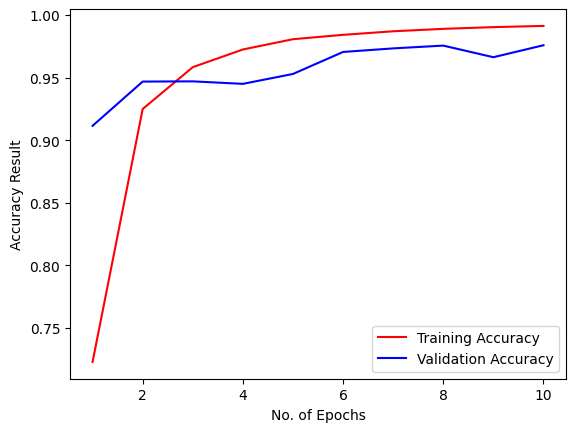

In [24]:
# Accuracy Visualization
epochs = [i for i in range(1, 11)]
plt.plot(epochs, training_history.history['accuracy'],color='red',label='Training Accuracy')
plt.plot(epochs, training_history.history['val_accuracy'],color='blue',label='Validation Accuracy')
plt.xlabel('No. of Epochs')
plt.ylabel('Accuracy Result')
plt.legend()
plt.show()

In [25]:
class_names = valid_set.class_names
print(class_names)

['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Sp

In [27]:
test_set = tf.keras.utils.image_dataset_from_directory(
    'valid',
    labels="inferred",
    label_mode="categorical",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(128, 128),
    shuffle=False,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation="bilinear",
    follow_links=False,
    crop_to_aspect_ratio=False,
)

Found 35144 files belonging to 38 classes.


In [28]:
y_pred = model.predict(test_set)
y_pred.shape

1099/1099 [==============================] - 26s 23ms/step


(35144, 38)

In [29]:
predicted_categories = tf.argmax(y_pred, axis=1)
true_categories = tf.concat([y for x, y in test_set], axis=0)
true_categories

<tf.Tensor: shape=(35144, 38), dtype=float32, numpy=
array([[1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.]], dtype=float32)>

In [30]:
Y_true = tf.argmax(true_categories, axis=1)
Y_true

<tf.Tensor: shape=(35144,), dtype=int64, numpy=array([ 0,  0,  0, ..., 37, 37, 37], dtype=int64)>

In [32]:
from sklearn.metrics import confusion_matrix, classification_report
classification_report(Y_true, predicted_categories, target_names=class_names)
classification_report

<function sklearn.metrics._classification.classification_report(y_true, y_pred, *, labels=None, target_names=None, sample_weight=None, digits=2, output_dict=False, zero_division='warn')>

In [33]:
cm = confusion_matrix(Y_true, predicted_categories)
cm.shape

(38, 38)

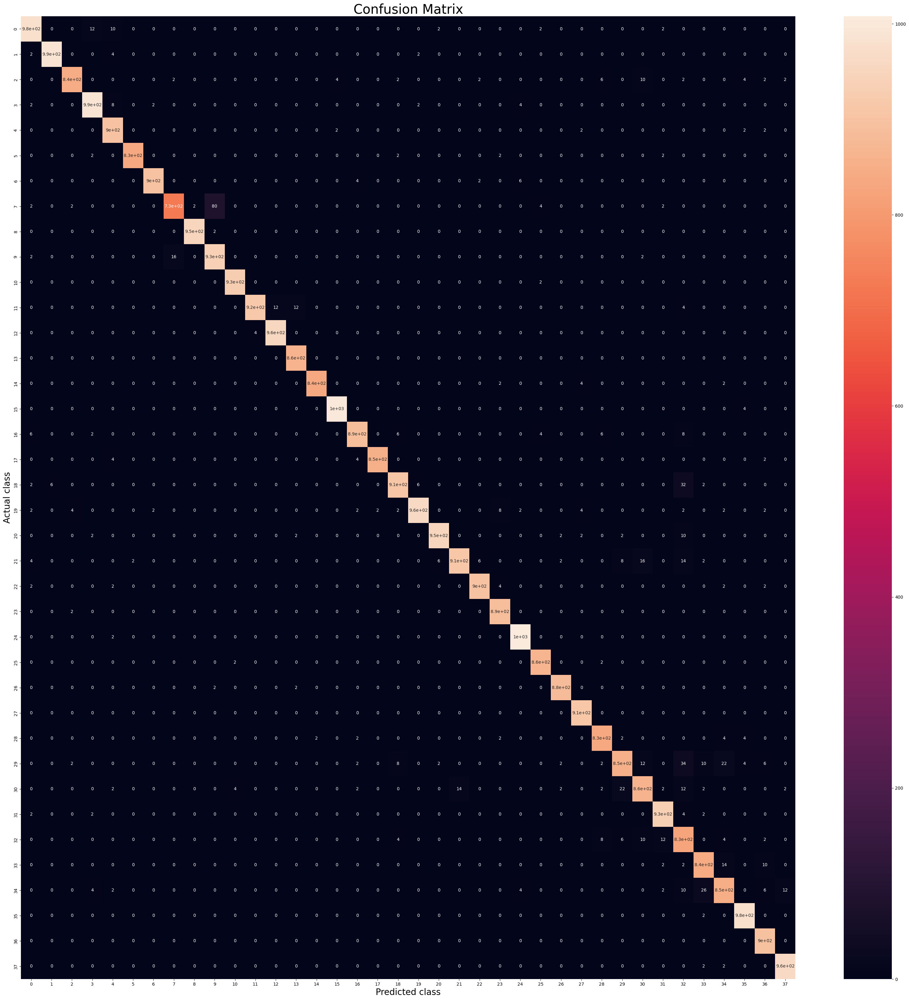

In [34]:
plt.figure(figsize=(40, 40))
sns.heatmap(cm,annot=True)
plt.xlabel('Predicted class',fontsize=20)
plt.ylabel('Actual class',fontsize=20)
plt.title('Confusion Matrix', fontsize=30)
plt.show()